<a href="https://colab.research.google.com/github/linhkid/GDG-DevFest-Codelab-24/blob/main/solutions/02-b-PGD-Adversarial-Attack-EfficientNet-AdvProp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Adversarial Attacks on Deep Learning Models: EfficientNet and AdvProp

## Introduction
In this workshop, we'll explore how to create adversarial examples that can fool deep learning models. We'll use EfficientNet and its Adversarial Propagation (AdvProp) variant as our target models, implementing a targeted Projected Gradient Descent (PGD) attack. This demonstrates both the vulnerabilities of deep learning models and techniques to make them more robust.

### What are Adversarial Propagation and EfficientNet?

- **Adversarial Propagation (AdvProp)**: A training method that improves adversarial robustness by propagating adversarial perturbations through the network during training. This helps the model learn to be robust against adversarial attacks.
- **EfficientNet**: A family of convolutional neural networks that achieve state-of-the-art accuracy with fewer parameters and FLOPS. EfficientNet models are known for their scalability and performance across various tasks.
- **Projected Gradient Descent (PGD)**: An iterative optimization technique used to generate adversarial examples. PGD attacks aim to maximize the model's loss by perturbing the input image within a specified epsilon range.

![PGD](../img/pgd.png)

### Learning Objectives
- Understand adversarial attacks and their implications for AI safety
- Implement targeted PGD attacks on image classification models
- Compare robustness between standard models and those trained with adversarial examples
- Learn about transfer learning and model fine-tuning

### Prerequisites
- Basic understanding of deep learning and computer vision
- Familiarity with TensorFlow and Keras
- GPU-enabled environment (recommended)
- Python 3.6 or later

## 1. Initial Setup

First, we'll set up our environment with the necessary dependencies:

In [2]:
# Install required packages
!pip install protobuf==3.20.*
!pip install tensorflow==2.8.0 tensorflow-gpu==2.8.0
!pip install tensorflow-datasets


# Import necessary libraries
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import tensorflow as tf

import tensorflow_datasets as tfds
tfds.disable_progress_bar()

import matplotlib.pyplot as plt
import numpy as np
import random
import shutil
import time
import cv2
import os

# Set random seeds for reproducibility
SEED = 666
tf.random.set_seed(SEED)
np.random.seed(SEED)


## 2. Dataset Preparation

We'll use the TensorFlow Flowers dataset, which provides a good balance between simplicity and real-world applicability:

In [3]:
# Load the Flowers dataset
train_ds, validation_ds = tfds.load(
    "tf_flowers",
    split=["train[:85%]", "train[85%:]"],
    as_supervised=True
)

# Define class labels
CLASSES = ["daisy", "dandelion", "roses", "sunflowers", "tulips"]

# Image preprocessing function
SIZE = (224, 224)

def preprocess_image(image, label):
    image = tf.image.resize(image, SIZE)
    return (image, label)

# Prepare datasets with batching and prefetching
BATCH_SIZE = 64
AUTO = tf.data.experimental.AUTOTUNE

train_ds = (
    train_ds
    .map(preprocess_image, num_parallel_calls=AUTO)
    .cache()
    .shuffle(1024)
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
)

validation_ds = (
    validation_ds
    .map(preprocess_image, num_parallel_calls=AUTO)
    .cache()
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
)

Dataset tf_flowers downloaded and prepared to /root/tensorflow_datasets/tf_flowers/3.0.1. Subsequent calls will reuse this data.



## 3. Model Architecture and Training

We'll create two variants of EfficientNet: one with standard ImageNet weights and another with AdvProp weights:

In [4]:
def get_training_model(base_model):
    inputs = Input(shape=(224, 224, 3))
    x = base_model(inputs, training=False)
    x = GlobalAveragePooling2D()(x)
    x = BatchNormalization()(x)
    x = Dropout(0.2)(x)
    x = Dense(5, activation="softmax")(x)
    return Model(inputs=inputs, outputs=x)

# Custom learning rate schedule
def lrfn(epoch):
    LR_START = 1e-5
    LR_MAX = 1e-2
    LR_RAMPUP_EPOCHS = 5
    LR_SUSTAIN_EPOCHS = 0
    LR_STEP_DECAY = 0.75

    if epoch < LR_RAMPUP_EPOCHS:
        lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
    elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
        lr = LR_MAX
    else:
        lr = LR_MAX * LR_STEP_DECAY**((epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS)//10)
    return lr

### Plot the progress

In [8]:
def plot_progress(hist):
    plt.plot(hist.history["loss"], label="train_loss")
    plt.plot(hist.history["val_loss"], label="validation_loss")
    plt.plot(hist.history["accuracy"], label="training_accuracy")
    plt.plot(hist.history["val_accuracy"], label="validation_accuracy")
    plt.title("Training Progress")
    plt.ylabel("accuracy/loss")
    plt.xlabel("epoch")
    plt.legend(loc="upper left")
    plt.show()

Fetch the [AdvProp](https://arxiv.org/abs/1911.09665) training checkpoints for EfficientNetB0 and convert the checkpoints to `.h5`.

In [9]:
!wget -q https://storage.googleapis.com/cloud-tpu-checkpoints/efficientnet/advprop/efficientnet-b0.tar.gz
!tar -xf efficientnet-b0.tar.gz

In [10]:
!wget -q https://raw.githubusercontent.com/yixingfu/tensorflow/updateweights/tensorflow/python/keras/applications/efficientnet_weight_update_util.py
!python efficientnet_weight_update_util.py --model b0 --notop --ckpt \
       efficientnet-b0/model.ckpt --o efficientnetb0_notop.h5

2024-10-25 11:31:04.809466: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.10/dist-packages/cv2/../../lib64:
2024-10-25 11:31:06.952119: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.10/dist-packages/cv2/../../lib64:
2024-10-25 11:31:06.952163: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
16719872/16705208 [==============================] - 0s 0us/step
check variables match in each block
blocks_0 and block1a match.
blocks_1 and block2a match.
blocks_2 and block2b match.
blocks_3 and block3a match.
blocks_4 and block3b match.
blocks_5 and block4a match.
blocks

### Training an EfficientNetB0 initialized with adversarial propagation (AdvProp) weights

In [11]:
# Load the EfficientNetB0 model but exclude the classification layers
# Note that the model was trained using AdvProp (https://arxiv.org/abs/1911.09665)
base_model_eb0_ap = EfficientNetB0(weights="efficientnetb0_notop.h5", include_top=False)
base_model_eb0_ap.trainable = False # We are not fine-tuning at this point
get_training_model(base_model_eb0_ap).summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb0 (Functional)  (None, None, None, 1280)  4049571  
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 batch_normalization (BatchN  (None, 1280)             5120      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 1280)              0         
                                                                 
 dense (Dense)               (None, 5)                 6405  

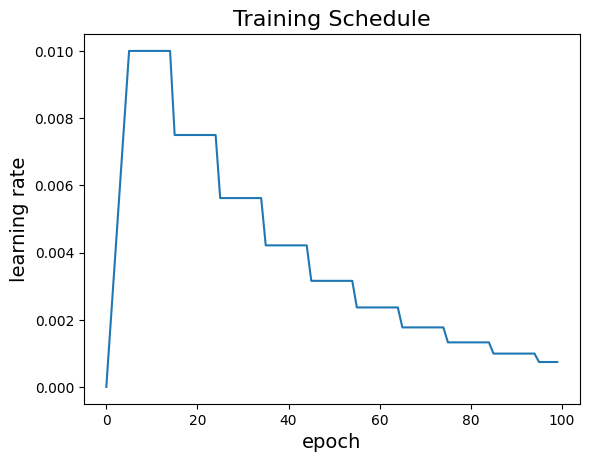

In [12]:
lr2 = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=True)

rng = [i for i in range(100)]
y = [lrfn(x) for x in rng]
plt.plot(rng, y);
plt.xlabel('epoch',size=14); plt.ylabel('learning rate',size=14)
plt.title('Training Schedule',size=16); plt.show()

In [13]:
# Early stopping callback
es = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss", patience=5, restore_best_weights=True
)


Epoch 1: LearningRateScheduler setting learning rate to 1e-05.
Epoch 1/30
49/49 [==============================] - 50s 913ms/step - loss: 2.3197 - accuracy: 0.2304 - val_loss: 1.7268 - val_accuracy: 0.2327 - lr: 1.0000e-05

Epoch 2: LearningRateScheduler setting learning rate to 0.0020080000000000002.
Epoch 2/30
49/49 [==============================] - 42s 852ms/step - loss: 0.7062 - accuracy: 0.7612 - val_loss: 0.3920 - val_accuracy: 0.8818 - lr: 0.0020

Epoch 3: LearningRateScheduler setting learning rate to 0.004006.
Epoch 3/30
49/49 [==============================] - 42s 850ms/step - loss: 0.2930 - accuracy: 0.8962 - val_loss: 0.3134 - val_accuracy: 0.8927 - lr: 0.0040

Epoch 4: LearningRateScheduler setting learning rate to 0.006004000000000001.
Epoch 4/30
49/49 [==============================] - 41s 845ms/step - loss: 0.1937 - accuracy: 0.9311 - val_loss: 0.2585 - val_accuracy: 0.9055 - lr: 0.0060

Epoch 5: LearningRateScheduler setting learning rate to 0.008002.
Epoch 5/30
49/4

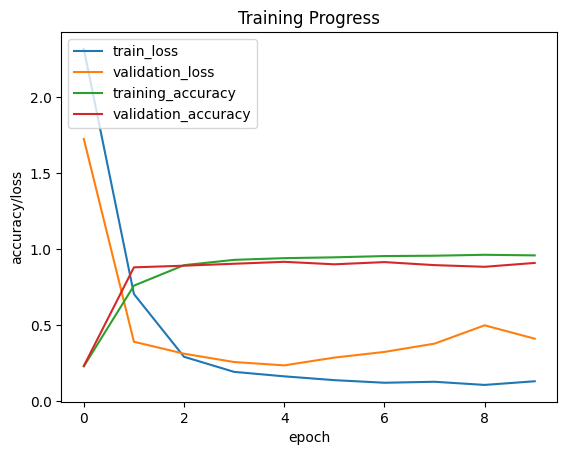

In [14]:
# Train the model
model_eb0_ap = get_training_model(base_model_eb0_ap)
model_eb0_ap.compile(loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"])
start = time.time()
h = model_eb0_ap.fit(train_ds,
              validation_data=validation_ds,
              epochs=30,
              callbacks=[lr2, es])
print("Total training time (seconds): ",time.time()-start)
plot_progress(h)

### Training an EfficientNetB0 initialized with ImageNet weights

In [15]:
# Load the EfficientNetB0 model but exclude the classification layers
# This time the weights are from traditional ImageNet pre-training
base_model_eb0 = EfficientNetB0(weights="imagenet", include_top=False)
base_model_eb0.trainable = False # We are not fine-tuning at this point


Epoch 1: LearningRateScheduler setting learning rate to 1e-05.
Epoch 1/30
49/49 [==============================] - 48s 884ms/step - loss: 2.3228 - accuracy: 0.2452 - val_loss: 1.7316 - val_accuracy: 0.2345 - lr: 1.0000e-05

Epoch 2: LearningRateScheduler setting learning rate to 0.0020080000000000002.
Epoch 2/30
49/49 [==============================] - 42s 862ms/step - loss: 0.6889 - accuracy: 0.7606 - val_loss: 0.3949 - val_accuracy: 0.8800 - lr: 0.0020

Epoch 3: LearningRateScheduler setting learning rate to 0.004006.
Epoch 3/30
49/49 [==============================] - 42s 851ms/step - loss: 0.3107 - accuracy: 0.8933 - val_loss: 0.3026 - val_accuracy: 0.9055 - lr: 0.0040

Epoch 4: LearningRateScheduler setting learning rate to 0.006004000000000001.
Epoch 4/30
49/49 [==============================] - 42s 859ms/step - loss: 0.1975 - accuracy: 0.9250 - val_loss: 0.2275 - val_accuracy: 0.9236 - lr: 0.0060

Epoch 5: LearningRateScheduler setting learning rate to 0.008002.
Epoch 5/30
49/4

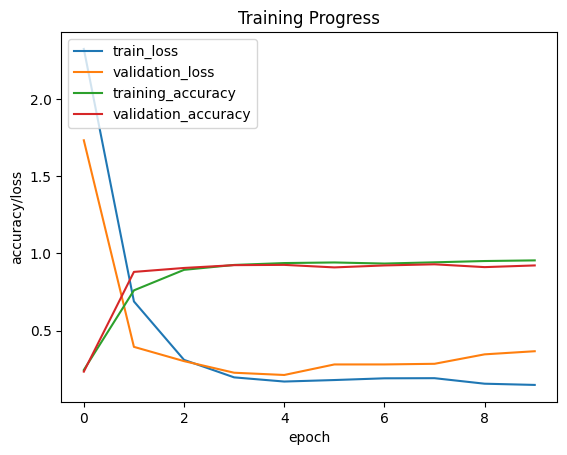

In [16]:
# Train the model
model_eb0 = get_training_model(base_model_eb0)
model_eb0.compile(loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"])
start = time.time()
h = model_eb0.fit(train_ds,
              validation_data=validation_ds,
              epochs=30,
              callbacks=[lr2, es])
print("Total training time (seconds): ",time.time()-start)
plot_progress(h)

### Plotting sample predictions

In [17]:
# Utility to plot sample predictions
def plot_predictions(images, labels, probability):
    plt.figure(figsize=(15, 15))
    for i, image in enumerate(images):
        ax = plt.subplot(4, 4, i + 1)
        plt.imshow(image.numpy().astype("uint8"))
        predicted_label = CLASSES[np.argmax(probability[i])]
        maximum_probability = "{:.3f}".format(max(probability[i]))
        text = "{} with probability: {}".format(predicted_label, maximum_probability) + \
            "\nGround-truth: {}".format(CLASSES[int(labels[i])])
        plt.title(text)
        plt.axis("off")
    plt.show()

### Inference with the regular EfficienNet model

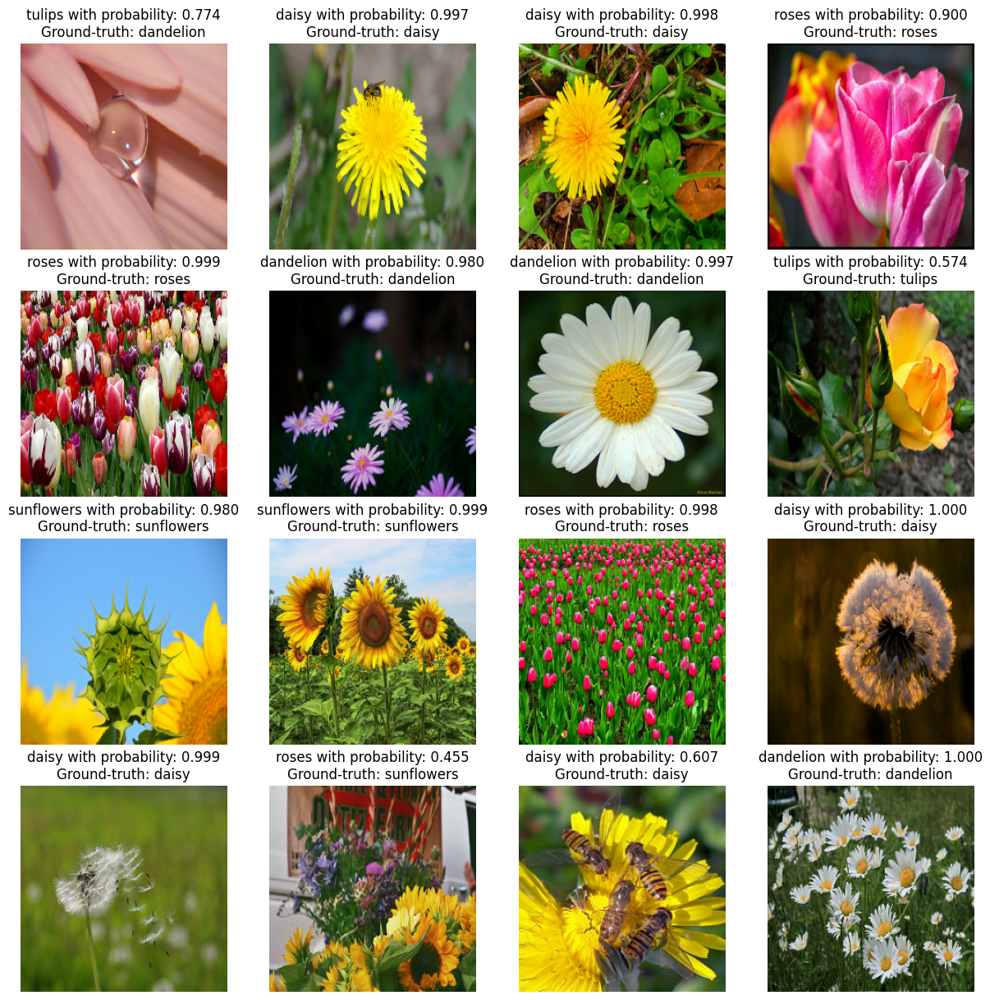

In [18]:
# Let's run inference on a batch of images from the validation set
(batch_images, batch_labels) = next(iter(validation_ds))
predictions = model_eb0.predict(batch_images)
plot_predictions(batch_images[:16], batch_labels[:16], predictions[:16])

### Inference with the AdvProp weights initialized EfficientNet model

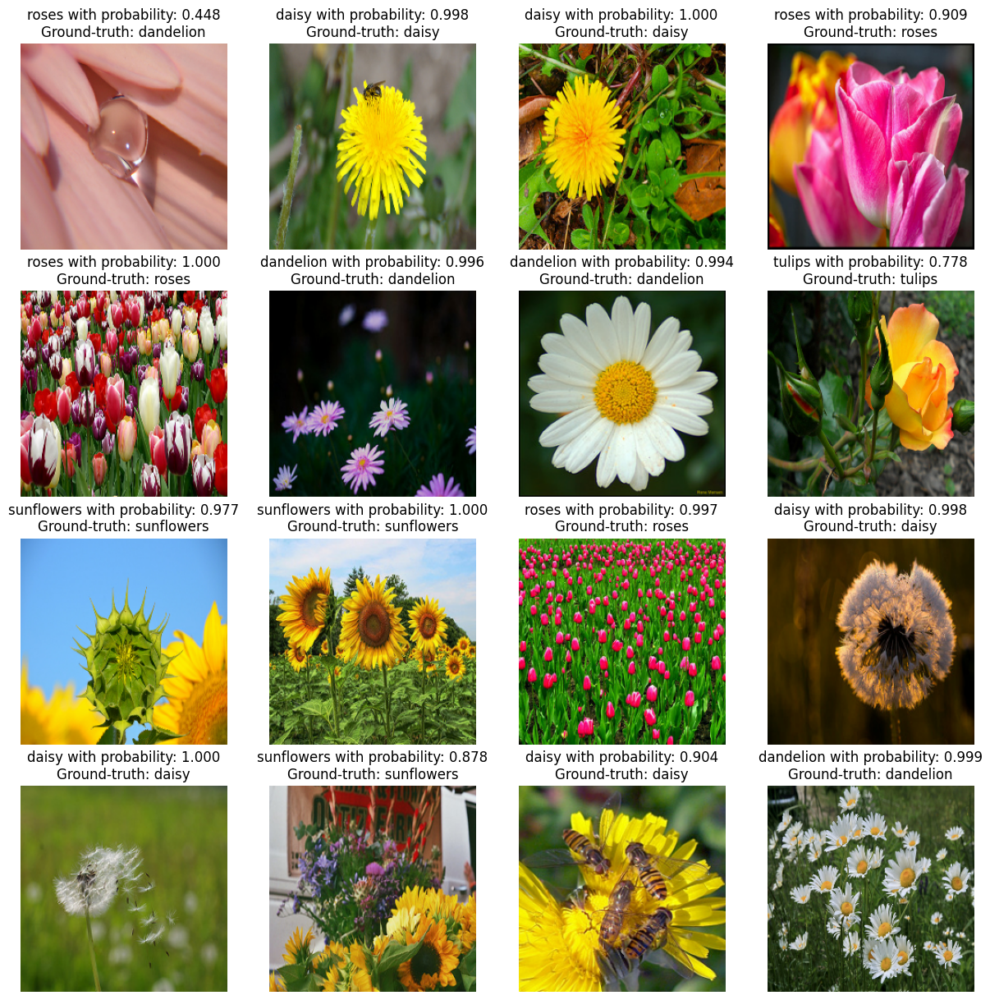

In [19]:
# Let's run inference on a batch of images from the validation set
(batch_images, batch_labels) = next(iter(validation_ds))
predictions = model_eb0_ap.predict(batch_images)
plot_predictions(batch_images[:16], batch_labels[:16], predictions[:16])

## 4. Adversarial Attack Implementation

Here we implement our targeted PGD attack:

In [20]:
EPS = 2./255

def clip_eps(delta_tensor):
    return tf.clip_by_value(delta_tensor, clip_value_min=-EPS, clip_value_max=EPS)


In this attack we will use PGD to simply maximize the loss for the given (true) class and at the same time minimize the loss for the target class such that the visual semantics of our input image does not get hampered.

In [21]:
def generate_adversaries_targeted(model, image_tensor, delta, true_index, target_index):
    scc_loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
    optimizer = tf.keras.optimizers.Adam(learning_rate=5e-3)

    for t in range(350):
        with tf.GradientTape() as tape:
            tape.watch(delta)
            inp = (image_tensor + delta)
            predictions = model(inp, training=False)
            loss = (- scc_loss(tf.convert_to_tensor([true_index]), predictions) +
                    scc_loss(tf.convert_to_tensor([target_index]), predictions))

            if t % 20 == 0:
                print(f"Step {t}, Loss: {loss.numpy():.4f}")
                plt.imshow(50*delta.numpy().squeeze()+0.5)
                plt.show()

        gradients = tape.gradient(loss, delta)
        optimizer.apply_gradients([(gradients, delta)])
        delta.assign_add(clip_eps(delta))

    return delta

def perturb_image(model, image, true, target):
    print("Before adversarial attack")
    probabilities = model.predict(image)
    class_index = np.argmax(probabilities)
    print(f"Ground-truth label: {CLASSES[true]} predicted label: {CLASSES[class_index]}")

    image_tensor = tf.constant(image, dtype=tf.float32)
    delta = tf.Variable(tf.zeros_like(image_tensor), trainable=True)
    delta_tensor = generate_adversaries_targeted(model, image_tensor, delta, true, target)

    perturbed_image = (image_tensor + delta_tensor)
    print("\nAfter adversarial attack")
    preds = model.predict(perturbed_image)[0]
    pred_label = CLASSES[np.argmax(preds)]
    print(f"Predicted label: {pred_label}")

    return perturbed_image, delta_tensor

## 5. Running the Attack

Now we can run our attack and visualize the results:

Attack on Standard EfficientNet:
Before adversarial attack
Ground-truth label: dandelion predicted label: dandelion
Step 0, Loss: 12.0839


/usr/local/lib/python3.10/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


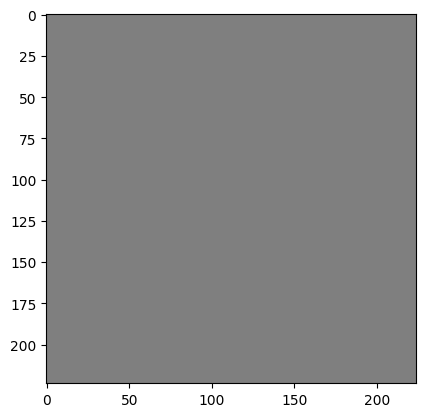

Step 20, Loss: 10.0550


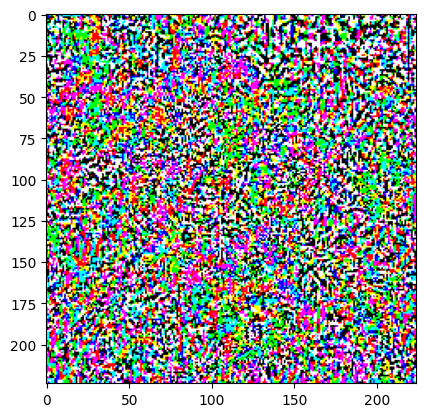

Step 40, Loss: 8.3668


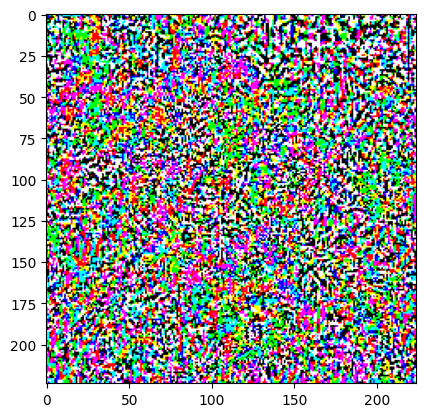

Step 60, Loss: 6.9922


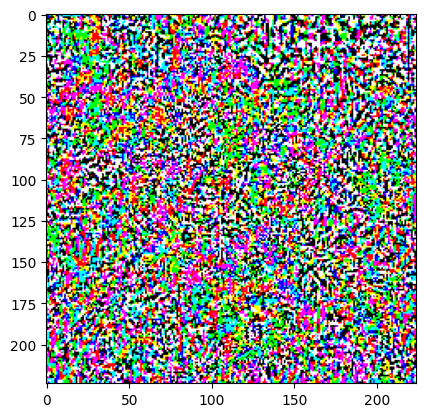

Step 80, Loss: 5.8402


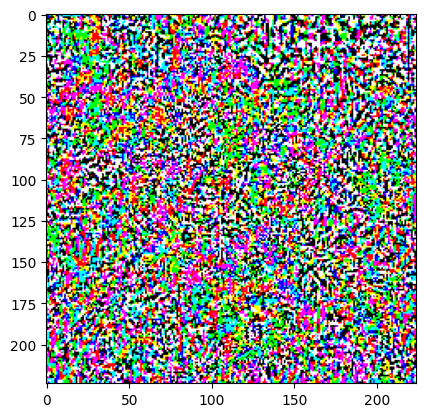

Step 100, Loss: 4.8437


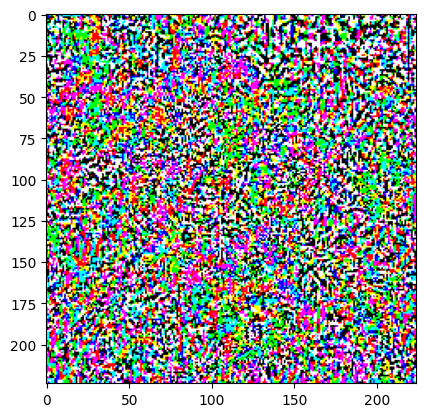

Step 120, Loss: 3.9526


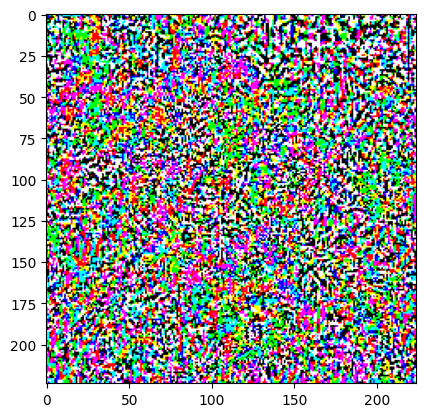

Step 140, Loss: 3.1282


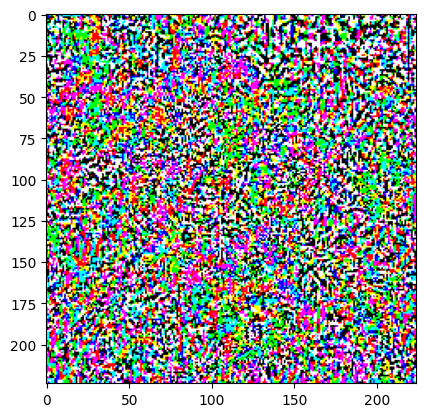

Step 160, Loss: 2.3411


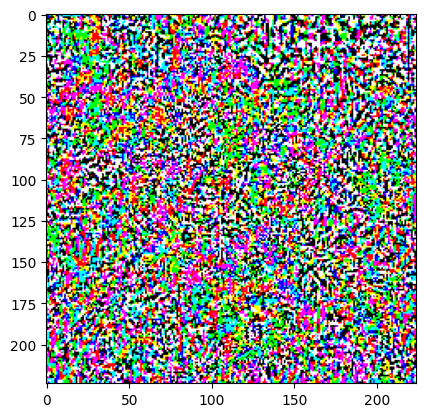

Step 180, Loss: 1.5676


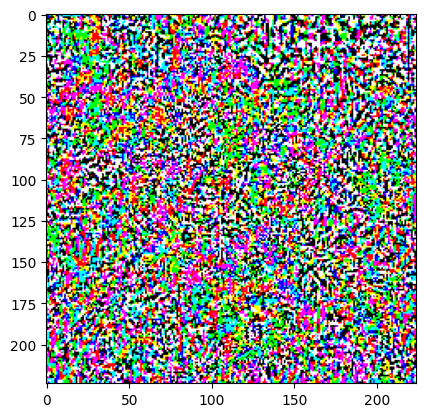

Step 200, Loss: 0.7869


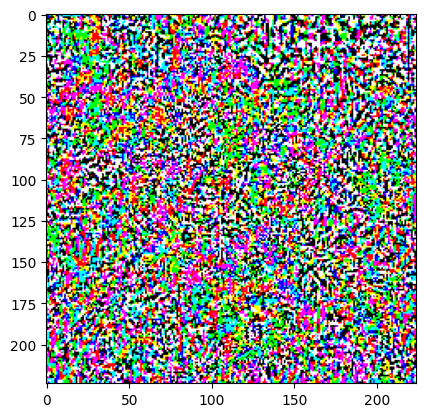

Step 220, Loss: -0.0200


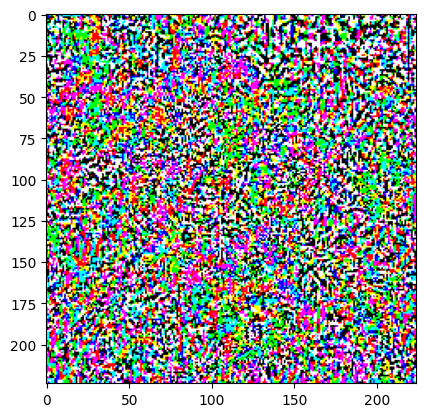

Step 240, Loss: -0.8709


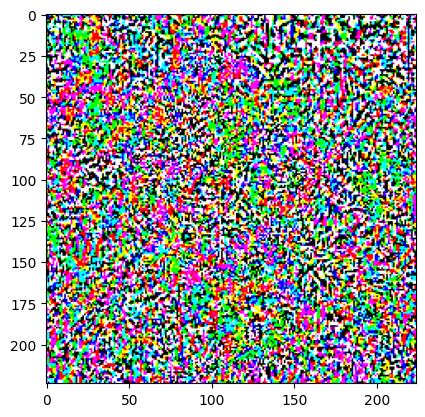

Step 260, Loss: -1.7823


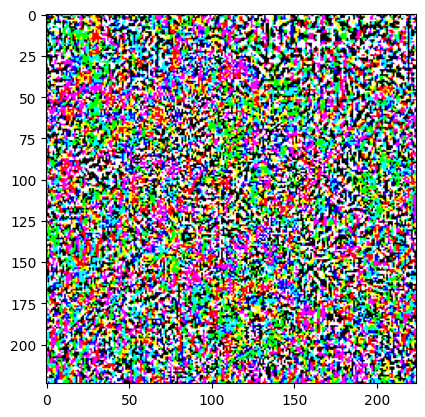

Step 280, Loss: -2.7682


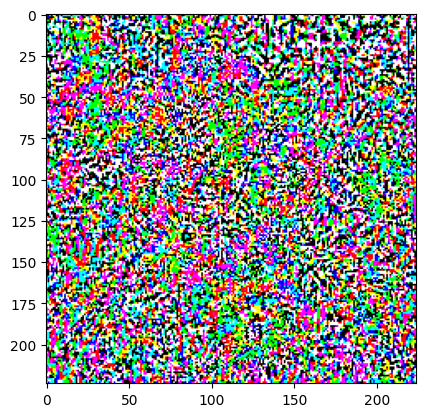

Step 300, Loss: -3.8428


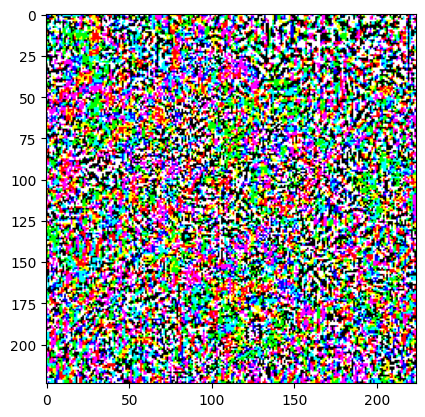

Step 320, Loss: -5.0271


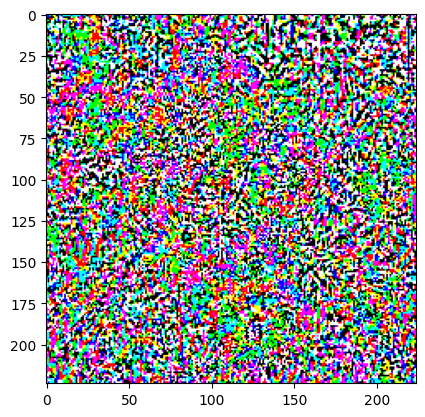

Step 340, Loss: -6.3569


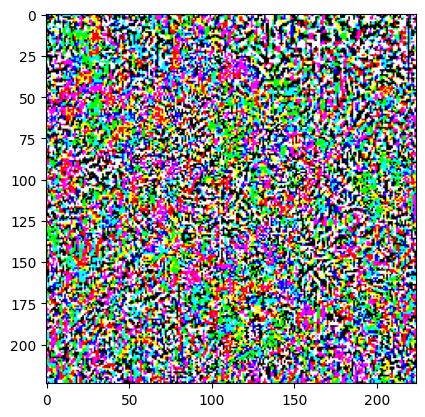


After adversarial attack
Predicted label: tulips

Attack on AdvProp EfficientNet:
Before adversarial attack
Ground-truth label: dandelion predicted label: dandelion
Step 0, Loss: 9.6873


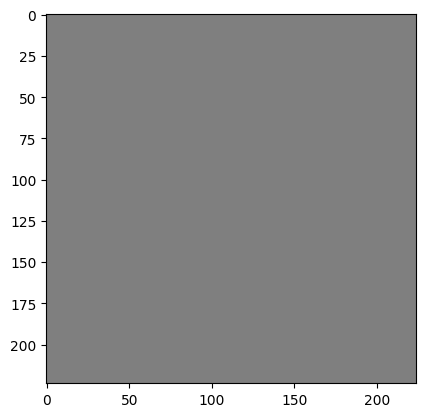

Step 20, Loss: 8.6216


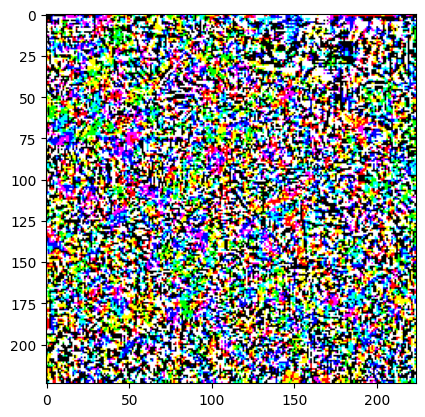

Step 40, Loss: 7.5360


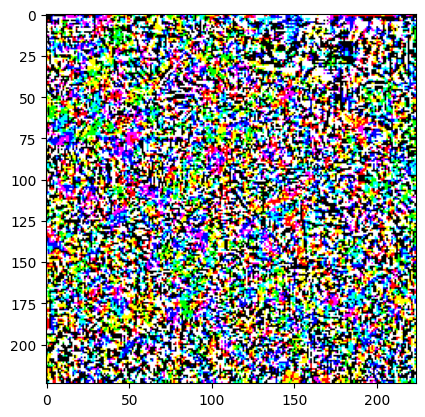

Step 60, Loss: 6.4222


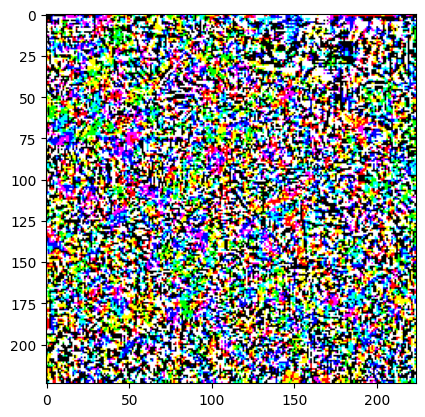

Step 80, Loss: 5.2624


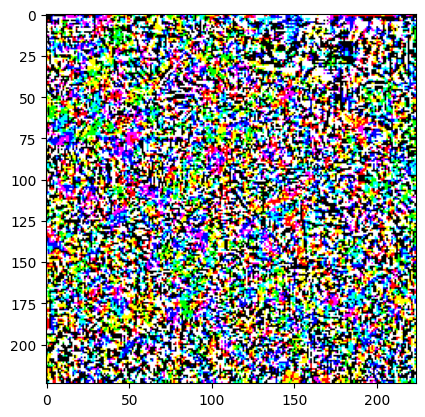

Step 100, Loss: 4.0472


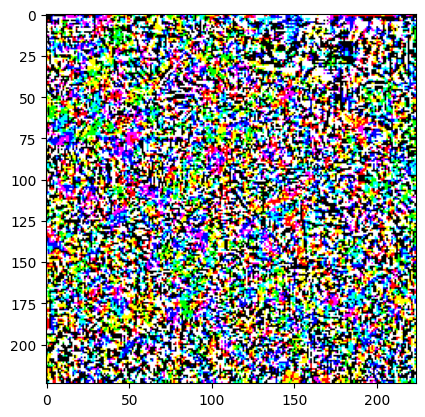

Step 120, Loss: 2.7762


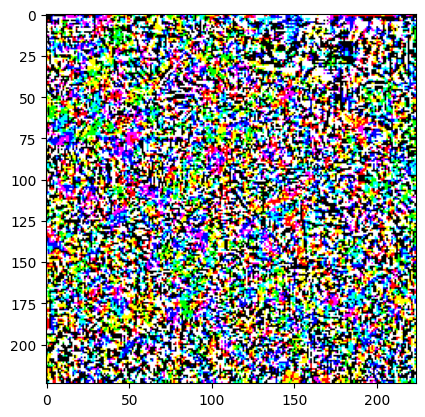

Step 140, Loss: 1.4799


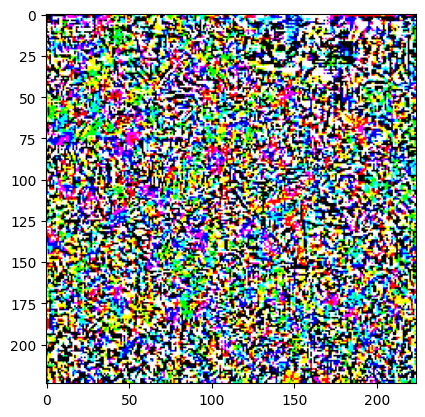

Step 160, Loss: 0.2088


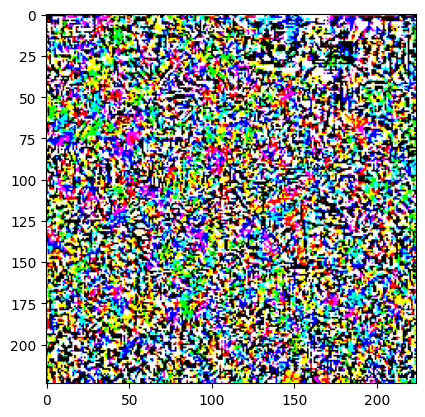

Step 180, Loss: -1.0085


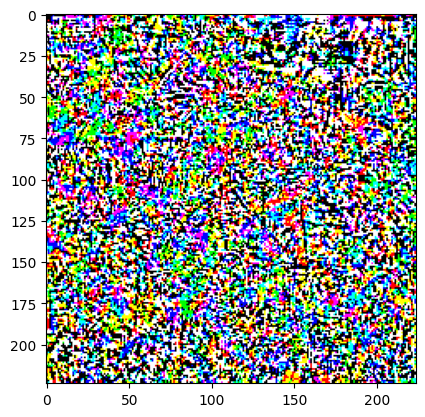

Step 200, Loss: -2.1727


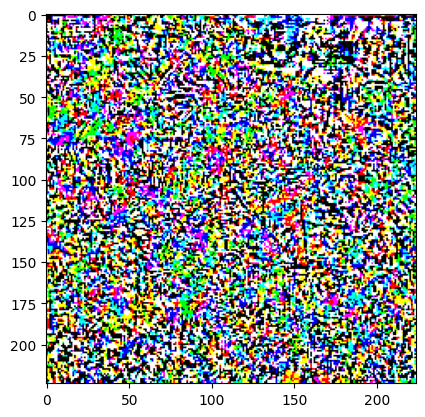

Step 220, Loss: -3.3054


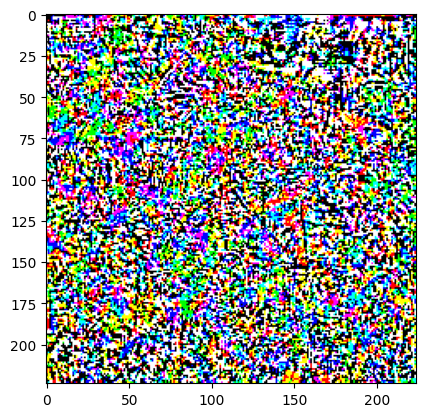

Step 240, Loss: -4.4280


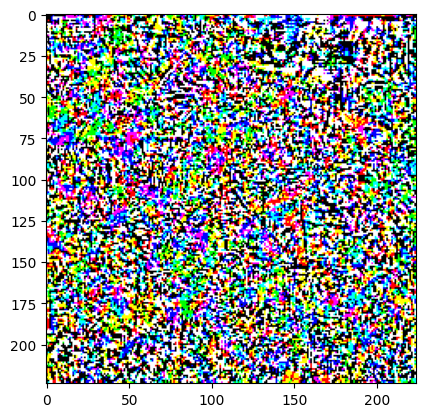

Step 260, Loss: -5.5516


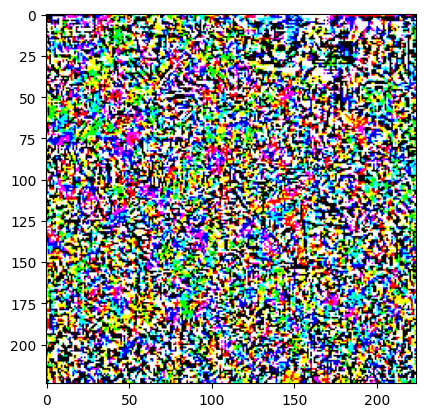

Step 280, Loss: -6.6793


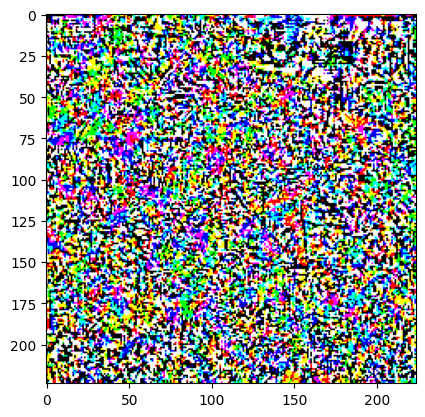

Step 300, Loss: -7.8121


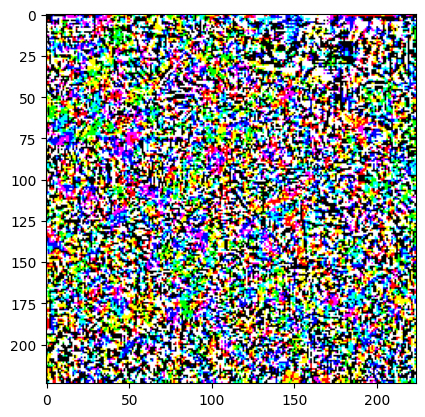

Step 320, Loss: -8.9543


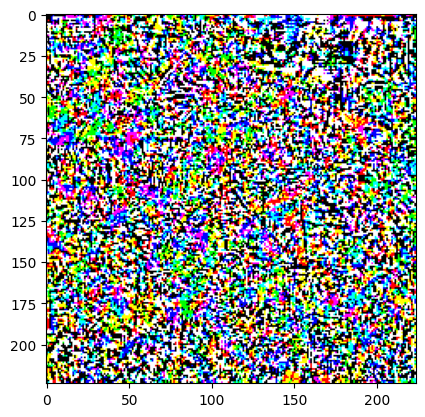

Step 340, Loss: -10.1153


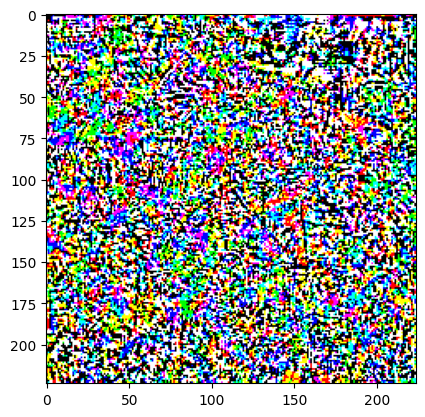


After adversarial attack
Predicted label: tulips


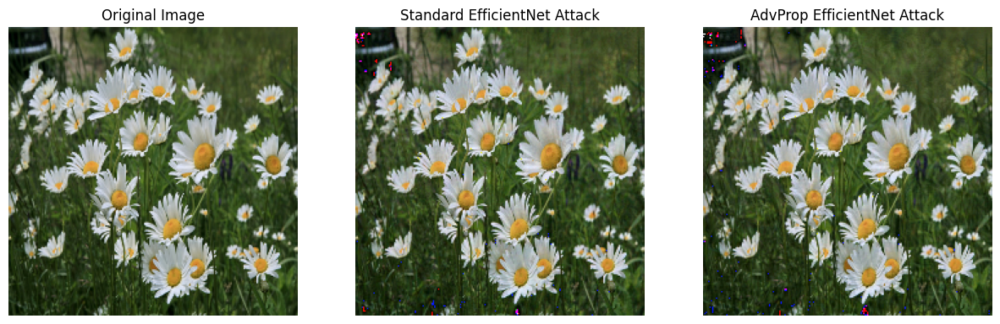

In [22]:


# Select a sample image
index = 15  # Example index
sample_val_image = np.expand_dims(batch_images[index], 0)

# Run attack on standard EfficientNet
print("Attack on Standard EfficientNet:")
perturbed_standard, delta_standard = perturb_image(
    model_eb0,
    sample_val_image,
    batch_labels[index].numpy(),
    4  # Target class (tulips)
)

# Run attack on AdvProp EfficientNet
print("\nAttack on AdvProp EfficientNet:")
perturbed_advprop, delta_advprop = perturb_image(
    model_eb0_ap,
    sample_val_image,
    batch_labels[index].numpy(),
    4  # Target class (tulips)
)

# Visualize results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(sample_val_image[0].astype("uint8"))
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(perturbed_standard[0].numpy().astype("uint8"))
plt.title("Standard EfficientNet Attack")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(perturbed_advprop[0].numpy().astype("uint8"))
plt.title("AdvProp EfficientNet Attack")
plt.axis("off")
plt.show()

## 6. Analysis and Discussion

### Key Observations
1. The adversarial perturbations are imperceptible to human eyes but can fool the model
2. AdvProp training provides some robustness against adversarial attacks
3. The attack success rate varies between the two models

### Security Implications
- Model vulnerabilities in real-world applications
- Importance of adversarial training
- Trade-offs between accuracy and robustness

## Additional Resources
1. [AdvProp Paper](https://arxiv.org/abs/1911.09665)
2. [EfficientNet Paper](https://arxiv.org/abs/1905.11946)
3. [PGD Attack Paper](https://arxiv.org/abs/1706.06083)

## Exercises for Participants
1. Try different epsilon values for the attack
2. Experiment with different target classes
3. Modify the attack algorithm parameters
4. Compare results with different model architectures